In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pwd
import os
os.chdir('/content/drive/My Drive/Colab Notebooks/GBC/Deep Learning Project')
!pwd

/content
/content/drive/My Drive/Colab Notebooks/GBC/Deep Learning Project


In [ ]:
!pip install tensorflow

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from xgboost import XGBRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import numpy as np
import tensorflow as tf
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM, GRU
from tensorflow.keras.optimizers import Adam
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from scipy.stats import randint

In [ ]:
# Define column names
column_names = ['engine', 'time', 'op_setting_1', 'op_setting_2', 'op_setting_3'] + [f'sm_{i}' for i in range(1, 22)]

In [ ]:
# Define sensor dictionary
Sensor_dictionary = {}
dict_list = [
    "(Fan inlet temperature) (◦R)", "(LPC outlet temperature) (◦R)", "(HPC outlet temperature) (◦R)",
    "(LPT outlet temperature) (◦R)", "(Fan inlet Pressure) (psia)", "(bypass-duct pressure) (psia)",
    "(HPC outlet pressure) (psia)", "(Physical fan speed) (rpm)", "(Physical core speed) (rpm)",
    "(Engine pressure ratio(P50/P2)", "(HPC outlet Static pressure) (psia)", "(Ratio of fuel flow to Ps30) (pps/psia)",
    "(Corrected fan speed) (rpm)", "(Corrected core speed) (rpm)", "(Bypass Ratio)", "(Burner fuel-air ratio)",
    "(Bleed Enthalpy)", "(Required fan speed)", "(Required fan conversion speed)",
    "(High-pressure turbines Cool air flow)", "(Low-pressure turbines Cool air flow)"
]
for i, x in enumerate(dict_list, 1):
    Sensor_dictionary[f'sm_{i}'] = x


In [ ]:
# Load the validation dataset
data_val = pd.read_csv('test_FD001.txt', header=None, names=column_names, index_col=False, delim_whitespace=True, engine='python')

<ipython-input-7-7b59e185bba3>:2: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  data_val = pd.read_csv('test_FD001.txt', header=None, names=column_names, index_col=False, delim_whitespace=True, engine='python')


In [ ]:
# Load the RUL values
y_val = pd.read_csv('RUL_FD001.txt', header=None, names=['RUL'])

In [ ]:
# Display the sensor dictionary
print(Sensor_dictionary)

{'sm_1': '(Fan inlet temperature) (◦R)', 'sm_2': '(LPC outlet temperature) (◦R)', 'sm_3': '(HPC outlet temperature) (◦R)', 'sm_4': '(LPT outlet temperature) (◦R)', 'sm_5': '(Fan inlet Pressure) (psia)', 'sm_6': '(bypass-duct pressure) (psia)', 'sm_7': '(HPC outlet pressure) (psia)', 'sm_8': '(Physical fan speed) (rpm)', 'sm_9': '(Physical core speed) (rpm)', 'sm_10': '(Engine pressure ratio(P50/P2)', 'sm_11': '(HPC outlet Static pressure) (psia)', 'sm_12': '(Ratio of fuel flow to Ps30) (pps/psia)', 'sm_13': '(Corrected fan speed) (rpm)', 'sm_14': '(Corrected core speed) (rpm)', 'sm_15': '(Bypass Ratio)', 'sm_16': '(Burner fuel-air ratio)', 'sm_17': '(Bleed Enthalpy)', 'sm_18': '(Required fan speed)', 'sm_19': '(Required fan conversion speed)', 'sm_20': '(High-pressure turbines Cool air flow)', 'sm_21': '(Low-pressure turbines Cool air flow)'}


In [ ]:
# # validataion set has 13096 samples , which belong to 100 engine data reading
# # y_val is rul of 100 engines in validation set modify for above code

print(data_val.shape, y_val.shape)


(13096, 26) (100, 1)


In [ ]:
# load training data
data_train = pd.read_csv('train_FD001.txt' , delim_whitespace=True , header=None , names=column_names , index_col=False )
data_train.shape

<ipython-input-11-cac06e1ec8cf>:2: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  data_train = pd.read_csv('train_FD001.txt' , delim_whitespace=True , header=None , names=column_names , index_col=False )


(20631, 26)

Data Preprocessing

In [ ]:
# make copy of original dataset , assing new name for dataframes
df = data_train.copy()
df_val = data_val.copy()
print(df.shape , df_val.shape)

(20631, 26) (13096, 26)


Data info

In [ ]:
# usefull info of dataset
df_info = pd.concat ( [df.isna().sum() , df.nunique() , df.dtypes] , axis = 1  )
df_info.columns = ['missing value' , 'number unique value' , 'dtype']
df_info
# no missing value , no categorical value , thanks!

,missing value,number unique value,dtype
engine,0,100,int64
time,0,362,int64
op_setting_1,0,158,float64
op_setting_2,0,13,float64
op_setting_3,0,1,float64
sm_1,0,1,float64
sm_2,0,310,float64
sm_3,0,3012,float64
sm_4,0,4051,float64
sm_5,0,1,float64


no missing values , no categorical values, Yay!!

Detect and Drop Nearly constant Features

In [ ]:
def constant_feature(df):
    constant_feature = []
    for col in df.columns:
        if df[col].std() < 0.02:
            constant_feature.append(col)
    return constant_feature


Drop features with a standard deviation less than 0.02. This identifies features with minimal variation, indicating they are likely constant or nearly constant as The standard deviation provides a more robust measure of variability compared to other measures

In [ ]:
print( constant_feature(df) )

df.drop(columns=constant_feature(df)  , inplace = True)
df_val.drop(columns=constant_feature(df) , inplace = True)

df.columns

['op_setting_1', 'op_setting_2', 'op_setting_3', 'sm_1', 'sm_5', 'sm_6', 'sm_10', 'sm_16', 'sm_18', 'sm_19']


Index(['engine', 'time', 'sm_2', 'sm_3', 'sm_4', 'sm_7', 'sm_8', 'sm_9',
       'sm_11', 'sm_12', 'sm_13', 'sm_14', 'sm_15', 'sm_17', 'sm_20', 'sm_21'],
      dtype='object')

Creating the RUL feature

In [ ]:
# defining RUL for training dataset
# RUL is rest useful life for each engines instant
# for engine 1 , max time will be true RUL , we can subtract every time from max time
# it gives us rul for each engins' states
# it is grouped data by engine , and for every engine , take time's columns , and take max value of time
# assign max times of each engine for all of engine's , then subtract it by its time , result is rul
def create_rul(df):
    df['rul'] = df.groupby('engine')['time'].transform('max') - df['time']
    return df
create_rul(df)

,engine,time,sm_2,sm_3,sm_4,sm_7,sm_8,sm_9,sm_11,sm_12,sm_13,sm_14,sm_15,sm_17,sm_20,sm_21,rul
0,1,1,641.82,1589.70,1400.60,554.36,2388.06,9046.19,47.47,521.66,2388.02,8138.62,8.4195,392,39.06,23.4190,191
1,1,2,642.15,1591.82,1403.14,553.75,2388.04,9044.07,47.49,522.28,2388.07,8131.49,8.4318,392,39.00,23.4236,190
2,1,3,642.35,1587.99,1404.20,554.26,2388.08,9052.94,47.27,522.42,2388.03,8133.23,8.4178,390,38.95,23.3442,189
3,1,4,642.35,1582.79,1401.87,554.45,2388.11,9049.48,47.13,522.86,2388.08,8133.83,8.3682,392,38.88,23.3739,188
4,1,5,642.37,1582.85,1406.22,554.00,2388.06,9055.15,47.28,522.19,2388.04,8133.80,8.4294,393,38.90,23.4044,187
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20626,100,196,643.49,1597.98,1428.63,551.43,2388.19,9065.52,48.07,519.49,2388.26,8137.60,8.4956,397,38.49,22.9735,4
20627,100,197,643.54,1604.50,1433.58,550.86,2388.23,9065.11,48.04,519.68,2388.22,8136.50,8.5139,395,38.30,23.1594,3
20628,100,198,643.42,1602.46,1428.18,550.94,2388.24,9065.90,48.09,520.01,2388.24,8141.05,8.5646,398,38.44,22.9333,2
20629,100,199,643.23,1605.26,1426.53,550.68,2388.25,9073.72,48.39,519.67,2388.23,8139.29,8.5389,395,38.29,23.0640,1


## Basic EDA

Detect highly correlated features

In [ ]:
mask = np.triu(np.ones(df.shape).astype(bool))
# np.ones( shape of matrix)    return matrix with 1 , shape is specified
# np.triu( matrix , k = 1 )    return upper triangle of matrix , k = 1 exclude diagnoal , k = 0 diagnoal included
# mask is a matrix with 0 value for all shape expect upper triangle

In [ ]:
df_corr = df.corr()
mask = np.tril(np.ones(df_corr.shape),k = -1).astype(bool)
df_corr = df_corr.where(mask)
df_corr

,engine,time,sm_2,sm_3,sm_4,sm_7,sm_8,sm_9,sm_11,sm_12,sm_13,sm_14,sm_15,sm_17,sm_20,sm_21,rul
engine,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
time,0.078753,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
sm_2,0.014133,0.549898,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
sm_3,0.012621,0.543947,0.602610,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
sm_4,0.026116,0.624577,0.714949,0.678413,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
sm_7,-0.032073,-0.595914,-0.702136,-0.664595,-0.793130,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
sm_8,0.039929,0.475977,0.662325,0.602481,0.746852,-0.767132,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
sm_9,-0.052053,0.443999,0.273764,0.322964,0.297429,-0.217835,-0.032091,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
sm_11,0.024707,0.634385,0.740020,0.695900,0.830136,-0.822805,0.782213,0.274591,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
sm_12,-0.031882,-0.611354,-0.724578,-0.680307,-0.815591,0.812713,-0.786540,-0.210238,-0.846884,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Generating a heatmap

<Axes: title={'center': 'correlation'}>

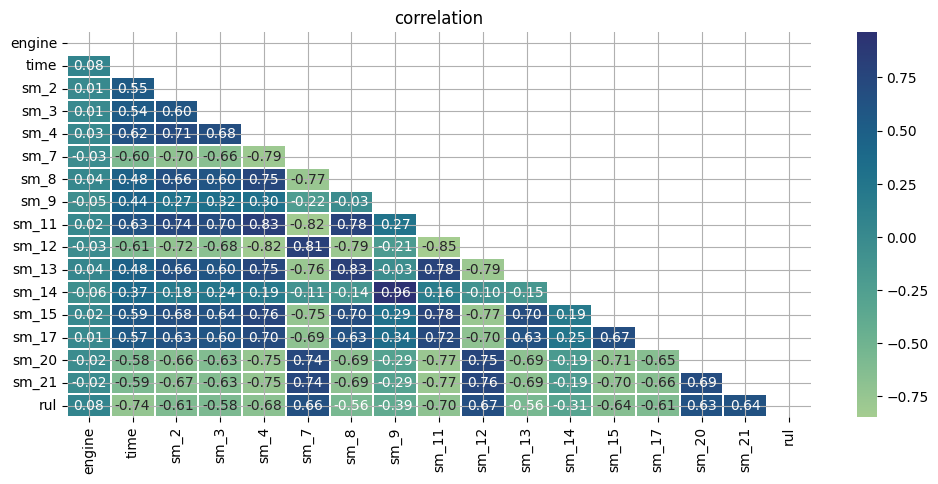

In [ ]:
plt.figure(figsize = (12,5))
plt.grid() , plt.title('correlation')
sns.heatmap(df_corr , annot=True , fmt = '0.2f' , cmap='crest' , linewidths=0.01)

RUL has good correlation with sensor measurements and While engine is an ID , so it is irrelevant

<Axes: >

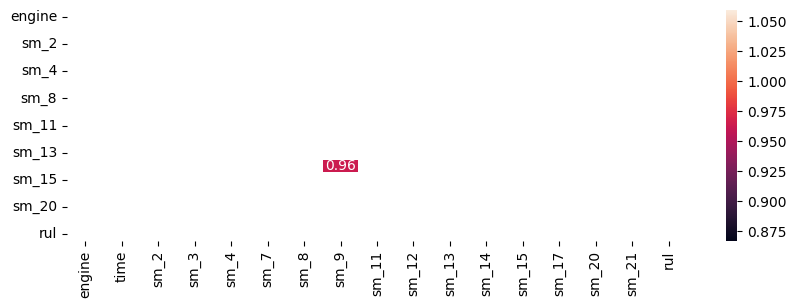

In [ ]:
# visualization high corrolated features
plt.figure(figsize = (10,3))
mask = df_corr.where( abs(df_corr) > 0.95 ).isna()
sns.heatmap(df_corr , annot=True , fmt = '0.2f' , linewidths=0.1 , mask = mask )

In [ ]:
# detect more than 95% correlation
high_corr = []
for col in df_corr.columns:
    for row in df_corr.index:
        if abs(df_corr.loc[col , row]) > 0.95 :
            high_corr.append((col , row))
high_corr

[('sm_14', 'sm_9')]

In [ ]:
# these 2 feature has very high correlation , both are not required , we can drop one of them
df.drop(columns = ['sm_9'] , inplace = True)

In [ ]:
df.columns

Index(['engine', 'time', 'sm_2', 'sm_3', 'sm_4', 'sm_7', 'sm_8', 'sm_11',
       'sm_12', 'sm_13', 'sm_14', 'sm_15', 'sm_17', 'sm_20', 'sm_21', 'rul'],
      dtype='object')

In [ ]:
!pip install pandas-profiling

In [ ]:
from ydata_profiling import ProfileReport
profile = ProfileReport(data_train , title='predictive maintenance')
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
data_train['time'].describe().T
# there is 100 units(engins)
# time in cycles is between 1 time - 362 in cycle , cycle could be every turbine run

,time
count,20631.000000
mean,108.807862
std,68.880990
min,1.000000
25%,52.000000
50%,104.000000
75%,156.000000
max,362.000000


In [ ]:
# max , or failure time for each engine , or max time cycle , that engine has worked.
failure_time = df.groupby('engine')['rul'].max()

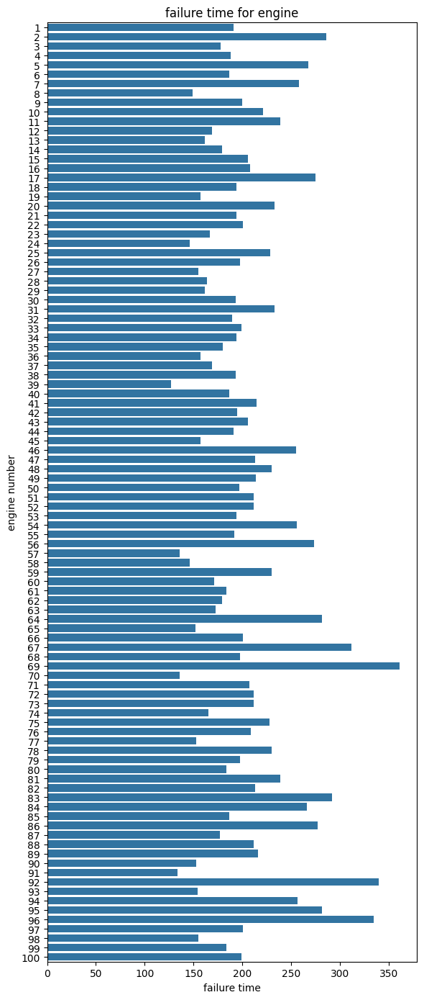

In [ ]:
plt.figure(figsize = (6,14))
sns.barplot(y = failure_time.index , x = failure_time.values , orient='h')
plt.title('failure time for engine')
plt.xlabel('failure time')
plt.ylabel('engine number')
plt.tight_layout()
plt.show()

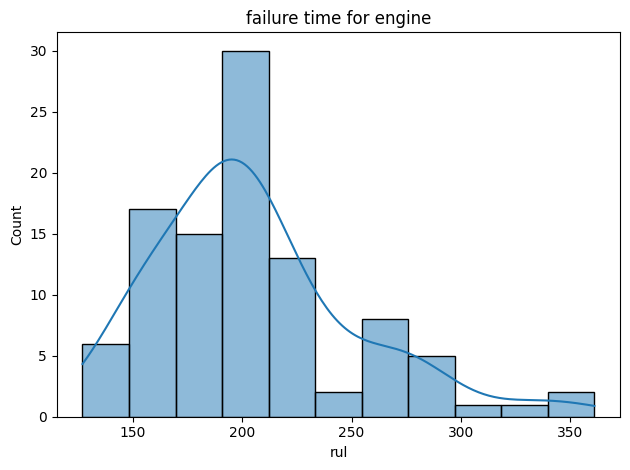

In [ ]:
# distribution of failure time per engine
sns.histplot(failure_time , kde=True)
plt.title('failure time for engine')
plt.tight_layout()

In [ ]:
min_failure_time = failure_time.min()
max_failure_time = failure_time.max()
mid_failure_time = (min_failure_time + max_failure_time) / 2

print(f"Minimum failure time: {min_failure_time}")
print(f"Mid-range failure time: {mid_failure_time}")
print(f"Maximum failure time: {max_failure_time}")

Minimum failure time: 127
Mid-range failure time: 244.0
Maximum failure time: 361


In [ ]:
# sensor visualization
def plot_signal(df , signal_name , Sensor_dictionary):
    figure = plt.figure(figsize=(10,4))

    for engine in df['engine'].unique():  # hint
        if (engine % 10 ==0 ):
            #print(engine)
            rolling_window = df[ df['engine']==engine ].rolling(10).mean()
            sns.lineplot( data = rolling_window , x = 'rul' , y =signal_name  , label =engine)

    plt.tight_layout(), plt.xlim(250 , 0)
    plt.xlabel('Remainded Usefull Life (RUL)') , plt.ylabel(Sensor_dictionary[signal_name])
    plt.show()

<Figure size 1000x400 with 0 Axes>

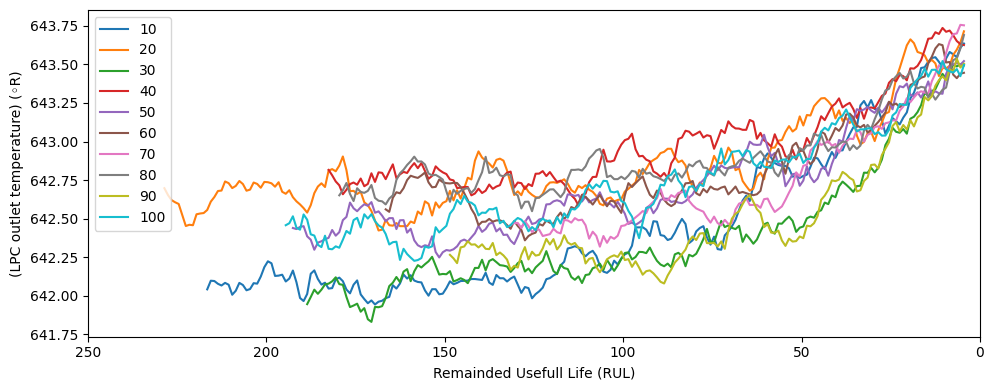

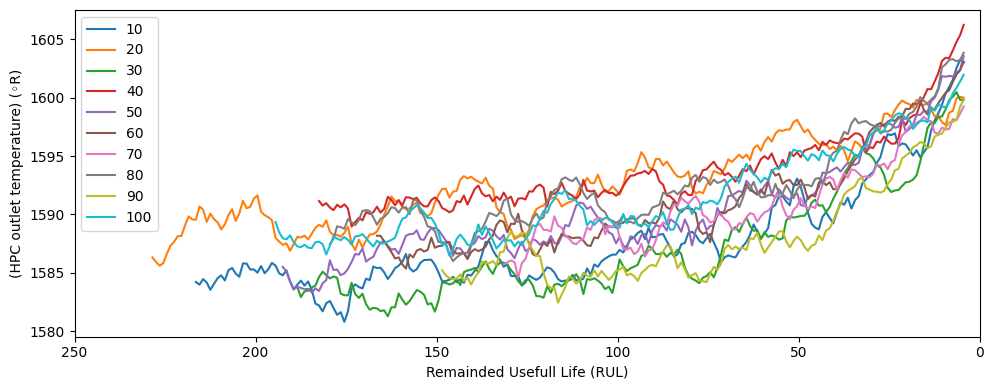

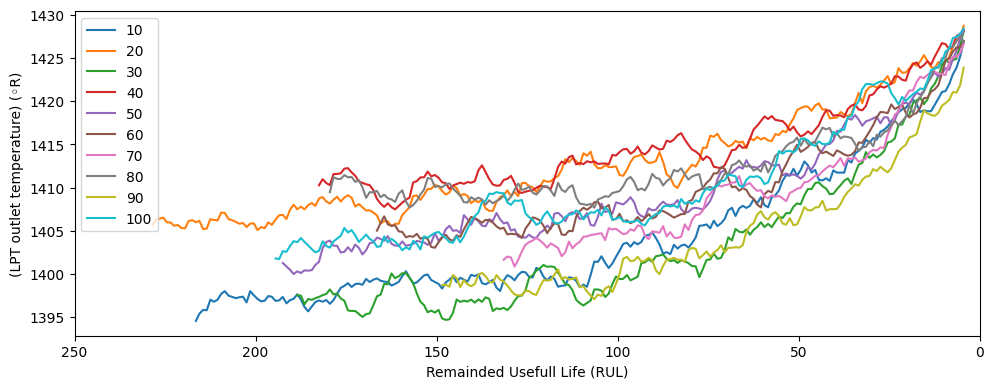

<Figure size 1000x400 with 0 Axes>

<Figure size 1000x400 with 0 Axes>

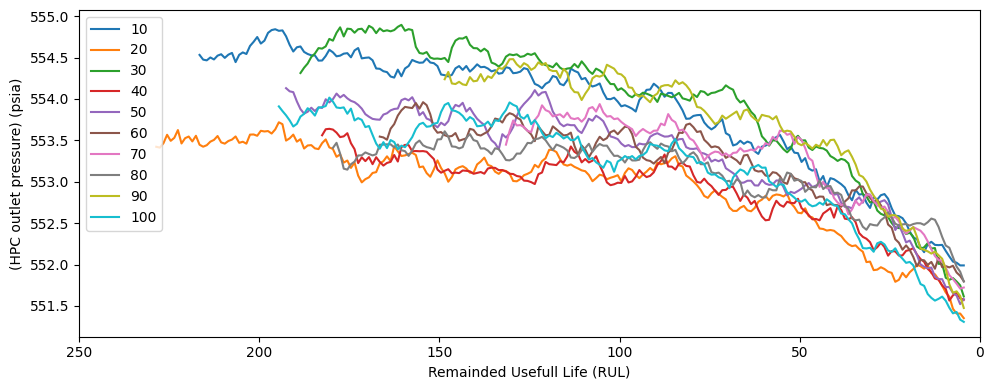

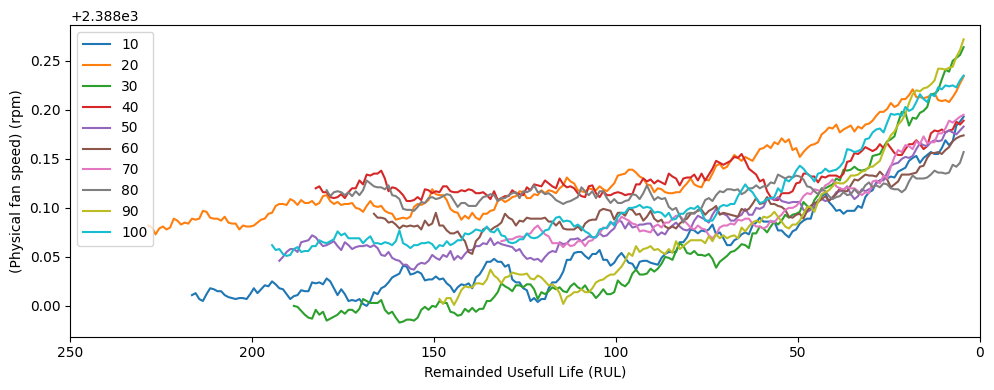

<Figure size 1000x400 with 0 Axes>

<Figure size 1000x400 with 0 Axes>

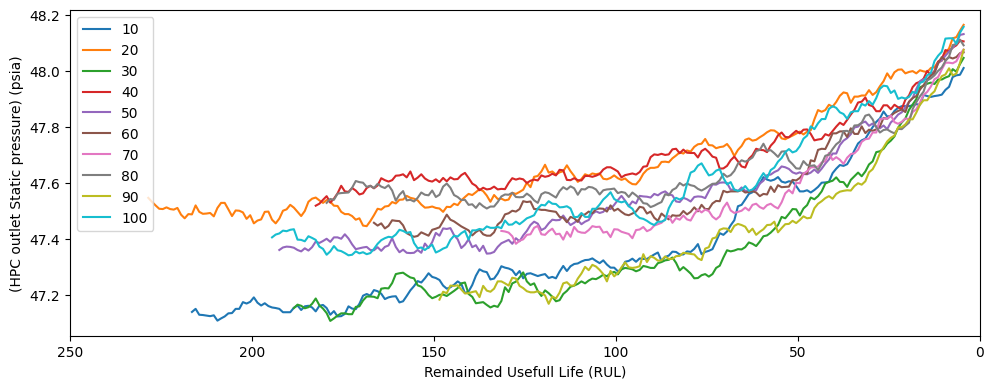

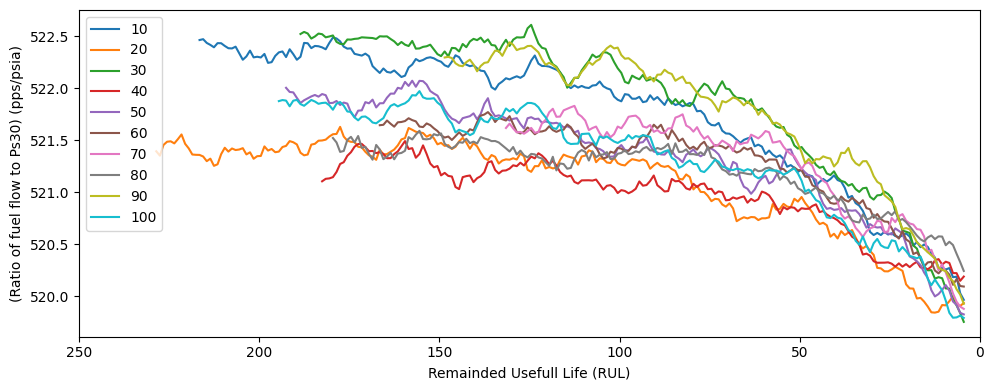

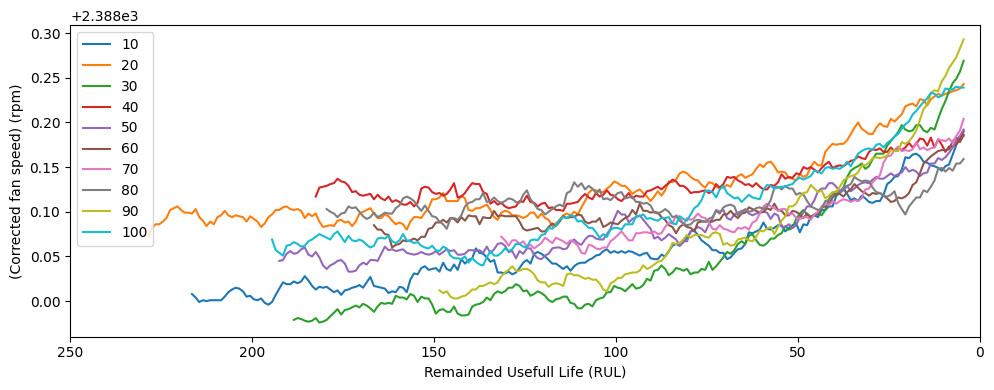

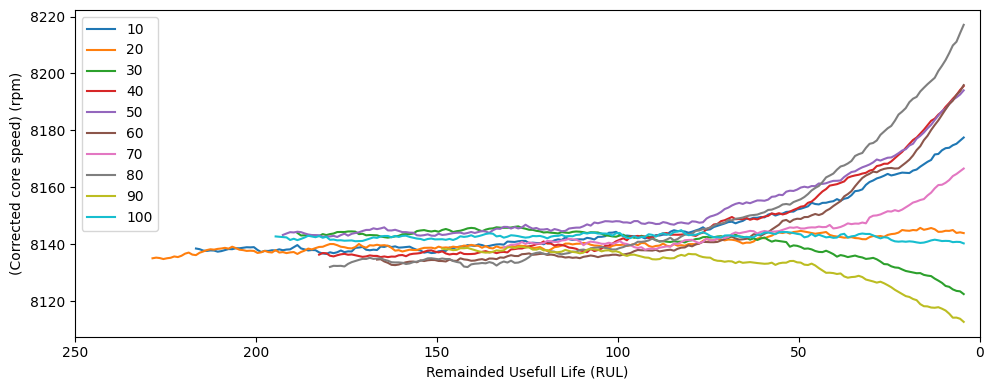

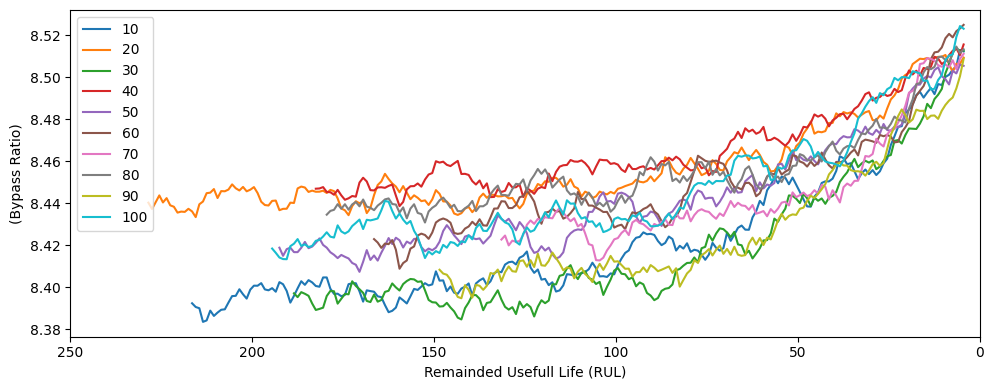

<Figure size 1000x400 with 0 Axes>

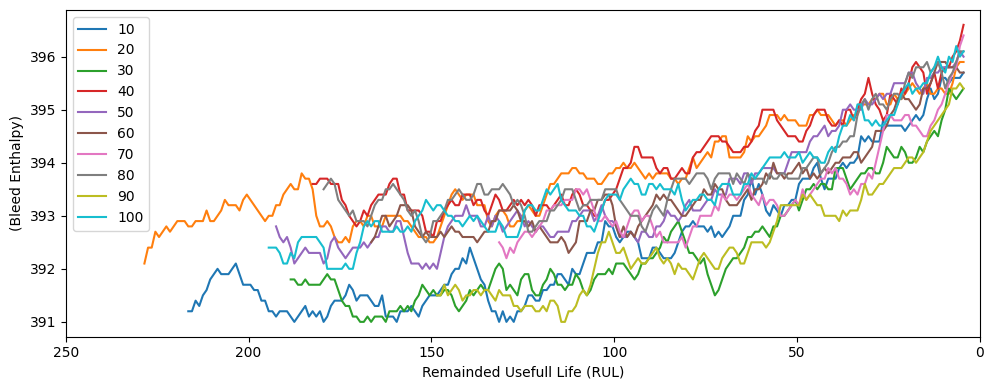

<Figure size 1000x400 with 0 Axes>

<Figure size 1000x400 with 0 Axes>

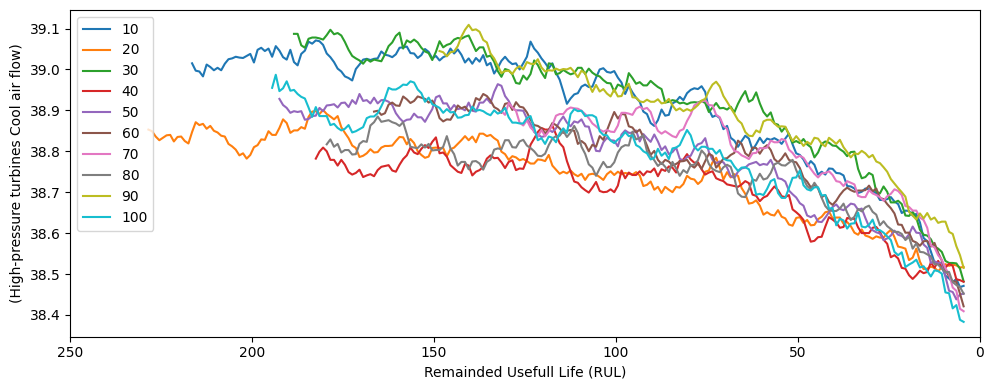

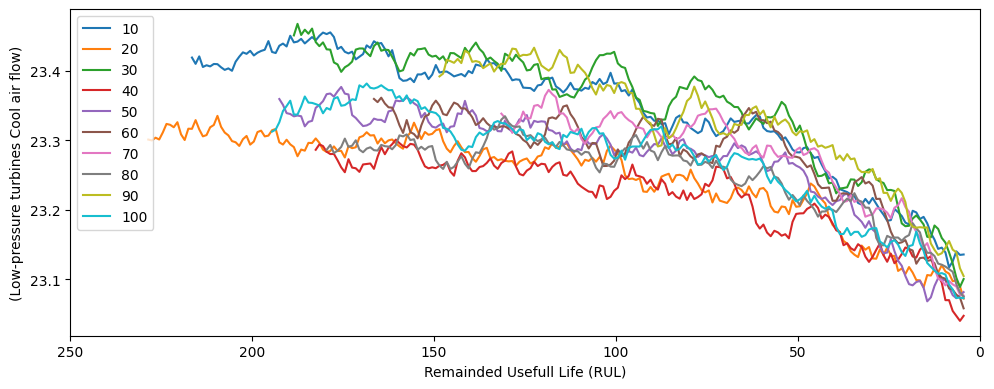

In [ ]:
for i in range (1,22):
    try:
        plot_signal(df , 'sm_'+str(i)  , Sensor_dictionary)
    except:
        pass

max time cycle , and RUL , they are opposite values of the same measure RUL at time cycle = 1 , means rest of useful life , at the beginning of the engine life , and it belongs in dataframe to time of 1 and max time in cycle for engine is equal to RUL of 0 which implies means failure at this point.

So, in this case our target (label , y) could be df['rul'] , or df['time'] so just one can be considered for our case. in the case of predictive maintenance it is common to consider RUL as target.

nasa has 3 sheet for dataset :
1.train with 26000 sample , named df , which , after preprocessing and EDA , and feature selection

2.test set with 13000 sample , name it df_val ( for misleading i choose validation name instead of test)

3.rul for test set (df_val) , name it y_val , and its shape is 100x1 ( target or label or RUL for every engine in validation set of nasa) so , df_train , df_val , y_val

Split df_train to train and test set X_train , X_test , y_train , y_test = train_test_split(X, y, test_size=0.2 , random_state=42)

for validation set , we take last registerd time for each engine , rul value for validation set (y_val) is rest useful time after max time of validation set , so take last reading of each engine , and convert validation set to 100 sample data , so X for validation set : X_val = df_val.groupby('engine').last().reset_index()
now , x_val is 100 sample of max time registerd in val set.

In [ ]:
#feature Selection
print(df.columns)
features = df.columns[2:-1]   # drop  engine , time , rul of  dataset
features                      # for X ( train and val)

Index(['engine', 'time', 'sm_2', 'sm_3', 'sm_4', 'sm_7', 'sm_8', 'sm_11',
       'sm_12', 'sm_13', 'sm_14', 'sm_15', 'sm_17', 'sm_20', 'sm_21', 'rul'],
      dtype='object')


Index(['sm_2', 'sm_3', 'sm_4', 'sm_7', 'sm_8', 'sm_11', 'sm_12', 'sm_13',
       'sm_14', 'sm_15', 'sm_17', 'sm_20', 'sm_21'],
      dtype='object')

In [ ]:
#we split train dataset to train and test , validation set
# train set
from sklearn.model_selection import train_test_split
X = df[features]
y = df['rul']

X_train , X_test , y_train , y_test  = train_test_split(X, y, test_size=0.3 , random_state=42)

In [ ]:
# validation set
X_val = df_val.groupby('engine').last().reset_index()    # take last row per engine , shows max time
X_val = X_val[features]   # no need for time in val set too

In [ ]:
X_train.shape , X_test.shape , X_val.shape

((14441, 13), (6190, 13), (100, 13))

Transforming Data

In [ ]:
# X ( X_train and X_test ) is scaled from 0 to 1 to prevent Data loss as there are variations in values.
from sklearn.preprocessing import MinMaxScaler , StandardScaler
scaler = MinMaxScaler(feature_range=(0,1))
X_train = scaler.fit_transform(X_train)

X_test = scaler.transform(X_test)            # transform test dataset
X_val = scaler.transform(X_val)

Model Estimations

Static Models


Evaluating Linear Regression...
Mean Absolute Error (MAE): 34.02
Mean Squared Error (MSE): 1972.23
Root Mean Squared Error (RMSE): 44.41
R-squared (R2): 0.57


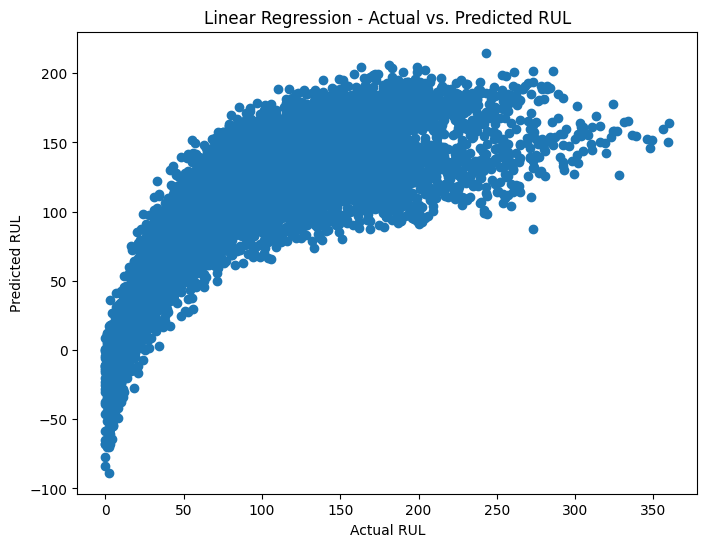


Evaluating Decision Tree...
Mean Absolute Error (MAE): 42.03
Mean Squared Error (MSE): 3578.68
Root Mean Squared Error (RMSE): 59.82
R-squared (R2): 0.22


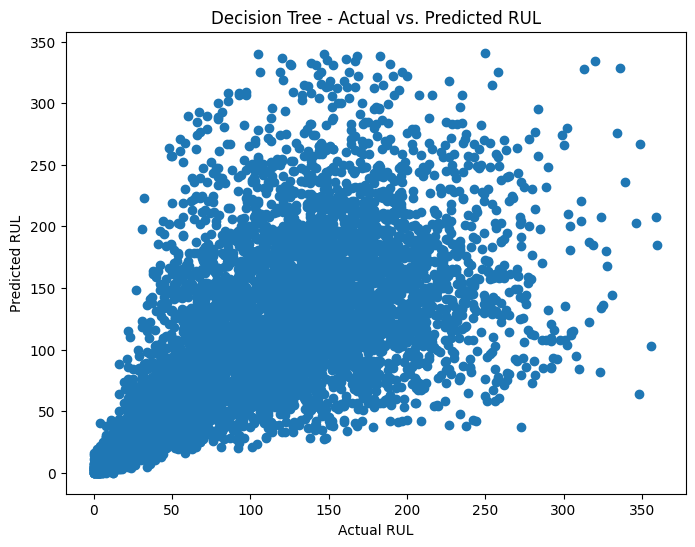


Evaluating Random Forest...
Mean Absolute Error (MAE): 30.15
Mean Squared Error (MSE): 1760.18
Root Mean Squared Error (RMSE): 41.95
R-squared (R2): 0.62


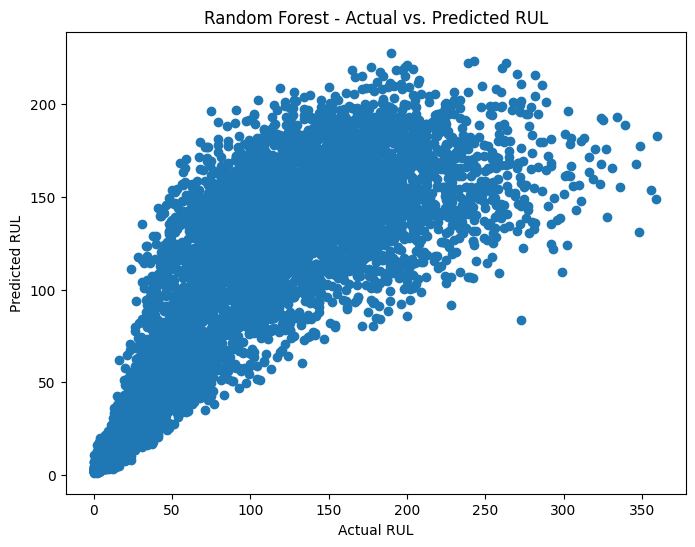


Evaluating Support Vector Regression...
Mean Absolute Error (MAE): 30.09
Mean Squared Error (MSE): 1817.51
Root Mean Squared Error (RMSE): 42.63
R-squared (R2): 0.60


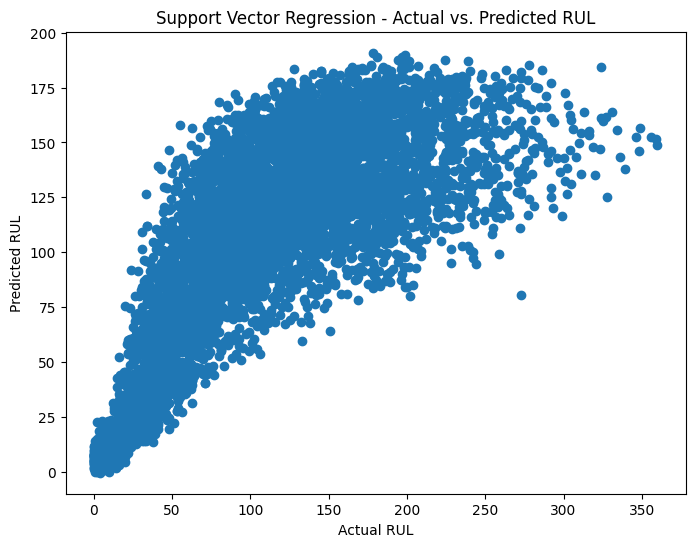


Evaluating XGBoost...
Mean Absolute Error (MAE): 31.27
Mean Squared Error (MSE): 1897.27
Root Mean Squared Error (RMSE): 43.56
R-squared (R2): 0.59


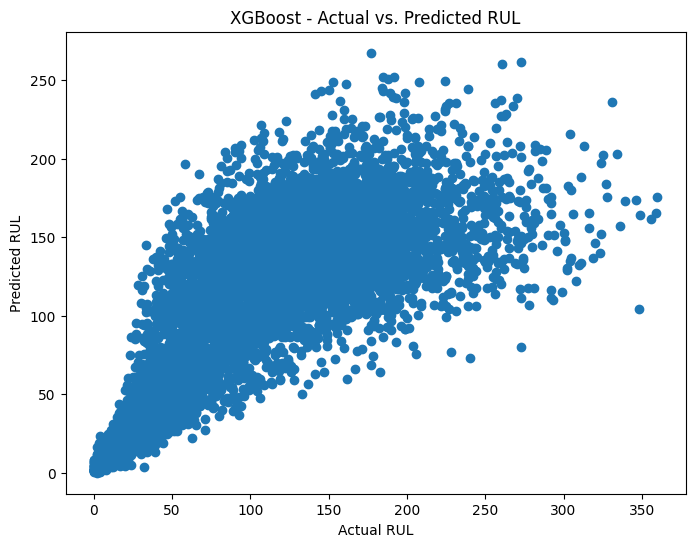

In [ ]:
# Regression Models
regression_models = {
    "Linear Regression": LinearRegression(),
    "Decision Tree": DecisionTreeRegressor(),
    "Random Forest": RandomForestRegressor(),
    "Support Vector Regression": SVR(),
    "XGBoost": XGBRegressor()
}

for model_name, model in regression_models.items():
    print(f"\nEvaluating {model_name}...")
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    mae = mean_absolute_error(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_test, y_pred)
    print(f"Mean Absolute Error (MAE): {mae:.2f}")
    print(f"Mean Squared Error (MSE): {mse:.2f}")
    print(f"Root Mean Squared Error (RMSE): {rmse:.2f}")
    print(f"R-squared (R2): {r2:.2f}")
    plt.figure(figsize=(8, 6))
    plt.scatter(y_test, y_pred)
    plt.xlabel("Actual RUL")
    plt.ylabel("Predicted RUL")
    plt.title(f"{model_name} - Actual vs. Predicted RUL")
    plt.show()



Dynamic Models

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - loss: 14327.7676 - val_loss: 11311.5791
Epoch 2/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 10808.7500 - val_loss: 9088.1348
Epoch 3/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 8611.0000 - val_loss: 7498.4023
Epoch 4/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 7428.4365 - val_loss: 6407.5059
Epoch 5/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 6168.4609 - val_loss: 5701.6172
Epoch 6/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 5554.2261 - val_loss: 5270.2461
Epoch 7/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 5084.9678 - val_loss: 5031.9702
Epoch 8/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 5021.0200 - val_loss: 4921.0410
Epoch 9/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4871.0400 - val_loss: 4874.7544
Epoch 10/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4810.2529 - val_loss: 4859.3311
Epoch 11/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4793.4688 - val

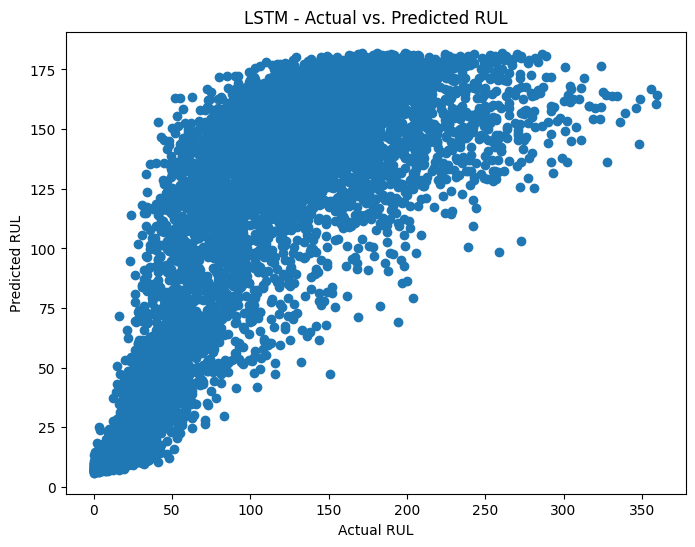

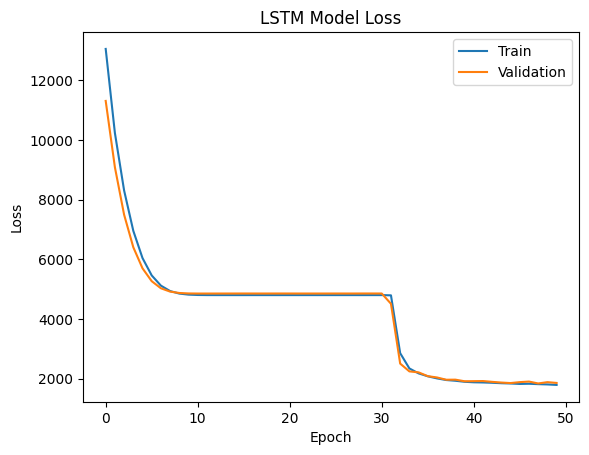

In [ ]:
# LSTM Model
model_lstm = Sequential()
model_lstm.add(LSTM(units=50, return_sequences=True, input_shape=(X_train.shape[1], 1)))
model_lstm.add(LSTM(units=50))
model_lstm.add(Dense(units=1))
optimizer = Adam(learning_rate=0.001)
model_lstm.compile(loss='mean_squared_error', optimizer=optimizer)
history_lstm = model_lstm.fit(X_train.reshape(-1, X_train.shape[1], 1), y_train, epochs=50, batch_size=32, validation_split=0.2)

# Evaluate LSTM
y_pred_lstm = model_lstm.predict(X_test.reshape(-1, X_test.shape[1], 1))
mae_lstm = mean_absolute_error(y_test, y_pred_lstm)
mse_lstm = mean_squared_error(y_test, y_pred_lstm)
rmse_lstm = np.sqrt(mse_lstm)
r2_lstm = r2_score(y_test, y_pred_lstm)

print("\nLSTM Model Evaluation:")
print(f"Mean Absolute Error (MAE): {mae_lstm:.2f}")
print(f"Mean Squared Error (MSE): {mse_lstm:.2f}")
print(f"Root Mean Squared Error (RMSE): {rmse_lstm:.2f}")
print(f"R-squared (R2): {r2_lstm:.2f}")

plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred_lstm)
plt.xlabel("Actual RUL")
plt.ylabel("Predicted RUL")
plt.title("LSTM - Actual vs. Predicted RUL")
plt.show()

# Learning rate graph LSTM
plt.plot(history_lstm.history['loss'])
plt.plot(history_lstm.history['val_loss'])
plt.title('LSTM Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper right')
plt.show()


Epoch 1/50


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


361/361 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 14337.2324 - val_loss: 11215.0303
Epoch 2/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 10814.9180 - val_loss: 8913.2881
Epoch 3/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 8452.7627 - val_loss: 7299.8496
Epoch 4/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 6938.3423 - val_loss: 6232.9082
Epoch 5/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 6002.2148 - val_loss: 5563.3438
Epoch 6/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 5407.3032 - val_loss: 5179.0737
Epoch 7/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 5103.8335 - val_loss: 4981.8057
Epoch 8/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4862.3989 - val_loss: 4896.0425
Epoch 9/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4849.9619 - val_loss: 4864.7651
Epoch 10/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4796.8721 - val_loss: 4857.0083
Epoch 11/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4771.1772 - val_loss: 4856

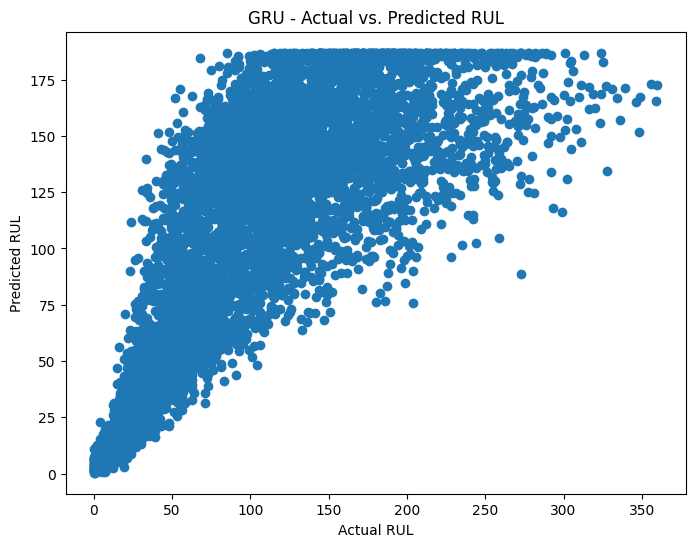

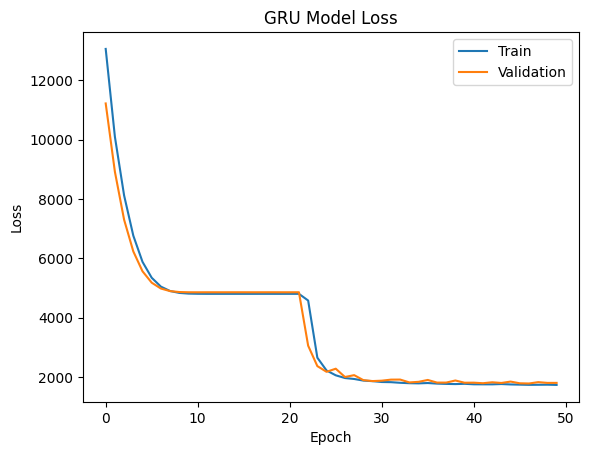

In [ ]:
# GRU Model
model_gru = Sequential()
model_gru.add(GRU(units=50, return_sequences=True, input_shape=(X_train.shape[1], 1)))
model_gru.add(GRU(units=50))
model_gru.add(Dense(units=1))
optimizer = Adam(learning_rate=0.001)
model_gru.compile(loss='mean_squared_error', optimizer=optimizer)
history_gru = model_gru.fit(X_train.reshape(-1, X_train.shape[1], 1), y_train, epochs=50, batch_size=32, validation_split=0.2)

# Evaluate GRU
y_pred_gru = model_gru.predict(X_test.reshape(-1, X_test.shape[1], 1))
mae_gru = mean_absolute_error(y_test, y_pred_gru)
mse_gru = mean_squared_error(y_test, y_pred_gru)
rmse_gru = np.sqrt(mse_gru)
r2_gru = r2_score(y_test, y_pred_gru)

print("\nGRU Model Evaluation:")
print(f"Mean Absolute Error (MAE): {mae_gru:.2f}")
print(f"Mean Squared Error (MSE): {mse_gru:.2f}")
print(f"Root Mean Squared Error (RMSE): {rmse_gru:.2f}")
print(f"R-squared (R2): {r2_gru:.2f}")

plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred_gru)
plt.xlabel("Actual RUL")
plt.ylabel("Predicted RUL")
plt.title("GRU - Actual vs. Predicted RUL")
plt.show()

# Learning rate graph GRU
plt.plot(history_gru.history['loss'])
plt.plot(history_gru.history['val_loss'])
plt.title('GRU Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper right')
plt.show()

Hyperparameter Selection - Model Training

In [ ]:
# Hyperparameter Tuning for Regression Models
best_models = {}
for model_name, model in regression_models.items():
    print(f"\nTuning {model_name}...")
    if model_name == "Linear Regression":
        param_grid = {}  # No hyperparameters to tune for Linear Regression
    elif model_name == "Decision Tree":
        param_grid = {
            'max_depth': [None, 10, 20, 30],
            'min_samples_split': [2, 5, 10],
            'min_samples_leaf': [1, 2, 4]
        }
    elif model_name == "Random Forest":
        param_grid = {
            'n_estimators': [50, 100, 200],
            'max_depth': [None, 10, 20],
            'min_samples_split': [2, 5, 10]
        }
    elif model_name == "Support Vector Regression":
        param_grid = {
            'kernel': ['linear', 'rbf', 'poly'],
            'C': [0.1, 1, 10],
            'gamma': ['scale', 'auto']
        }
    elif model_name == "XGBoost":
        param_grid = {
            'n_estimators': [50, 100, 200],
            'max_depth': [3, 5, 7],
            'learning_rate': [0.01, 0.1, 0.2]
        }

    grid_search = GridSearchCV(model, param_grid, cv=5, scoring='neg_mean_squared_error', n_jobs=-1)
    grid_search.fit(X_train, y_train)
    best_models[model_name] = {
        'model': grid_search.best_estimator_,
        'best_params': grid_search.best_params_,
        'best_score': -grid_search.best_score_
    }
    print(f"Best parameters: {grid_search.best_params_}")
    print(f"Best MSE: {-grid_search.best_score_}")


# Hyperparameter Tuning for LSTM and GRU
# Define parameter space for LSTM and GRU
lstm_param_grid = {
    'units': [50, 100],
    'learning_rate': [0.001, 0.01],
    'epochs': [50, 100]
}


# Function to create and train LSTM/GRU model with given parameters
def create_and_train_lstm_gru(model_type, units, learning_rate, epochs):
    if model_type == 'lstm':
        model = Sequential()
        model.add(LSTM(units=units, return_sequences=True, input_shape=(X_train.shape[1], 1)))
        model.add(LSTM(units=units))
        model.add(Dense(units=1))
        optimizer = Adam(learning_rate=learning_rate)
        model.compile(loss='mean_squared_error', optimizer=optimizer)
        history = model.fit(X_train.reshape(-1, X_train.shape[1], 1), y_train, epochs=epochs, batch_size=32, validation_split=0.2)
        return model, history
    elif model_type == 'gru':
        model = Sequential()
        model.add(GRU(units=units, return_sequences=True, input_shape=(X_train.shape[1], 1)))
        model.add(GRU(units=units))
        model.add(Dense(units=1))
        optimizer = Adam(learning_rate=learning_rate)
        model.compile(loss='mean_squared_error', optimizer=optimizer)
        history = model.fit(X_train.reshape(-1, X_train.shape[1], 1), y_train, epochs=epochs, batch_size=32, validation_split=0.2)
        return model, history


# Tune LSTM hyperparameters
print("\nTuning LSTM...")
best_lstm_mse = float('inf')
best_lstm_params = {}
for units in lstm_param_grid['units']:
    for learning_rate in lstm_param_grid['learning_rate']:
        for epochs in lstm_param_grid['epochs']:
            lstm_model, lstm_history = create_and_train_lstm_gru('lstm', units, learning_rate, epochs)
            y_pred_lstm = lstm_model.predict(X_test.reshape(-1, X_test.shape[1], 1))
            mse_lstm = mean_squared_error(y_test, y_pred_lstm)
            if mse_lstm < best_lstm_mse:
                best_lstm_mse = mse_lstm
                best_lstm_params = {'units': units, 'learning_rate': learning_rate, 'epochs': epochs}
print(f"Best LSTM parameters: {best_lstm_params}")
print(f"Best LSTM MSE: {best_lstm_mse}")

# Tune GRU hyperparameters
print("\nTuning GRU...")
best_gru_mse = float('inf')
best_gru_params = {}
for units in lstm_param_grid['units']:
    for learning_rate in lstm_param_grid['learning_rate']:
        for epochs in lstm_param_grid['epochs']:
            gru_model, gru_history = create_and_train_lstm_gru('gru', units, learning_rate, epochs)
            y_pred_gru = gru_model.predict(X_test.reshape(-1, X_test.shape[1], 1))
            mse_gru = mean_squared_error(y_test, y_pred_gru)
            if mse_gru < best_gru_mse:
                best_gru_mse = mse_gru
                best_gru_params = {'units': units, 'learning_rate': learning_rate, 'epochs': epochs}
print(f"Best GRU parameters: {best_gru_params}")
print(f"Best GRU MSE: {best_gru_mse}")

# Select the best model based on MSE
best_overall_model = min(best_models, key=lambda k: best_models[k]['best_score'])
best_overall_mse = best_models[best_overall_model]['best_score']

if best_lstm_mse < best_overall_mse:
    best_overall_model = 'LSTM'
    best_overall_mse = best_lstm_mse

if best_gru_mse < best_overall_mse:
    best_overall_model = 'GRU'
    best_overall_mse = best_gru_mse

print(f"\nBest Overall Model: {best_overall_model}")
print(f"Best Overall MSE: {best_overall_mse}")


Tuning Linear Regression...
Best parameters: {}
Best MSE: 2015.093287639543

Tuning Decision Tree...
Best parameters: {'max_depth': 10, 'min_samples_leaf': 4, 'min_samples_split': 10}
Best MSE: 2122.4716964872887

Tuning Random Forest...
Best parameters: {'max_depth': 10, 'min_samples_split': 2, 'n_estimators': 200}
Best MSE: 1744.0371925293598

Tuning Support Vector Regression...
Best parameters: {'C': 10, 'gamma': 'scale', 'kernel': 'rbf'}
Best MSE: 1786.8689297746616

Tuning XGBoost...
Best parameters: {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 50}
Best MSE: 1747.8226387737236

Tuning LSTM...
Epoch 1/50


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


361/361 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 14390.3779 - val_loss: 11196.1162
Epoch 2/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 10783.9082 - val_loss: 8916.9053
Epoch 3/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 8541.6338 - val_loss: 7323.2241
Epoch 4/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 7082.3472 - val_loss: 6260.9180
Epoch 5/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 6042.6899 - val_loss: 5587.2300
Epoch 6/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 5582.0342 - val_loss: 5196.5093
Epoch 7/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 5073.6133 - val_loss: 4991.5815
Epoch 8/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4941.2700 - val_loss: 4899.6924
Epoch 9/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4873.6060 - val_loss: 4867.6343
Epoch 10/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4933.2466 - val_loss: 4857.4053
Epoch 11/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4796.6768 - val_loss: 4856

194/194 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


361/361 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - loss: 14668.1465 - val_loss: 11301.7227
Epoch 2/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 10828.3906 - val_loss: 8994.8184
Epoch 3/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 8473.2275 - val_loss: 7377.6250
Epoch 4/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 7099.1582 - val_loss: 6294.9893
Epoch 5/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 6179.4497 - val_loss: 5608.9067
Epoch 6/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 5378.8511 - val_loss: 5209.4429
Epoch 7/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 5211.6372 - val_loss: 4999.6445
Epoch 8/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4979.0239 - val_loss: 4904.3525
Epoch 9/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4856.2583 - val_loss: 4867.4180
Epoch 10/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4837.4565 - val_loss: 4857.4927
Epoch 11/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4805.0962 - val_

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


361/361 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 9846.4414 - val_loss: 4868.6445
Epoch 2/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4819.4253 - val_loss: 4857.7632
Epoch 3/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4813.7607 - val_loss: 4858.5029
Epoch 4/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4849.5698 - val_loss: 4862.3931
Epoch 5/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4906.8442 - val_loss: 4856.5874
Epoch 6/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4819.6636 - val_loss: 4863.3228
Epoch 7/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4646.4565 - val_loss: 4857.2617
Epoch 8/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4849.1870 - val_loss: 4868.1743
Epoch 9/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4840.3979 - val_loss: 4856.1914
Epoch 10/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4943.9238 - val_loss: 4858.9175
Epoch 11/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4756.1450 - val_loss: 4857.43

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


361/361 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 9667.1523 - val_loss: 4866.1089
Epoch 2/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4781.9653 - val_loss: 4856.8013
Epoch 3/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4777.8833 - val_loss: 4856.3828
Epoch 4/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4783.8916 - val_loss: 4856.1782
Epoch 5/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4775.2852 - val_loss: 4858.6982
Epoch 6/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4848.5742 - val_loss: 4858.5630
Epoch 7/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4730.7534 - val_loss: 4863.8779
Epoch 8/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4928.1738 - val_loss: 4856.0811
Epoch 9/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4883.3862 - val_loss: 4861.6611
Epoch 10/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4896.7598 - val_loss: 4856.3950
Epoch 11/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4816.7358 - val_los

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


361/361 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 12928.0137 - val_loss: 8589.8711
Epoch 2/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 8033.2573 - val_loss: 6173.2407
Epoch 3/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 5889.7925 - val_loss: 5203.3540
Epoch 4/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 5100.5928 - val_loss: 4918.8413
Epoch 5/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4885.2173 - val_loss: 4861.1636
Epoch 6/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4843.8887 - val_loss: 4856.0850
Epoch 7/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4752.5596 - val_loss: 4856.8062
Epoch 8/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4788.6255 - val_loss: 4857.5454
Epoch 9/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4867.9922 - val_loss: 4857.4995
Epoch 10/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4785.5645 - val_loss: 4856.4434
Epoch 11/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4740.0508 - val_loss: 4856.2

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


361/361 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 12857.0996 - val_loss: 8642.6670
Epoch 2/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 7881.8101 - val_loss: 6193.7070
Epoch 3/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 5780.4155 - val_loss: 5218.7407
Epoch 4/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 5145.2886 - val_loss: 4922.7593
Epoch 5/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4876.4209 - val_loss: 4862.8086
Epoch 6/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4894.8403 - val_loss: 4856.0864
Epoch 7/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4854.9956 - val_loss: 4856.4541
Epoch 8/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4798.3120 - val_loss: 4856.7964
Epoch 9/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4851.2104 - val_loss: 4857.4790
Epoch 10/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4740.8833 - val_loss: 4858.2861
Epoch 11/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4872.1958 - val_lo

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


361/361 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 7999.2925 - val_loss: 4857.5640
Epoch 2/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4836.9238 - val_loss: 4861.2012
Epoch 3/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4777.8569 - val_loss: 4860.1792
Epoch 4/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4813.5054 - val_loss: 4863.0132
Epoch 5/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4878.1592 - val_loss: 4856.0791
Epoch 6/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4789.2178 - val_loss: 4870.0371
Epoch 7/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4932.9180 - val_loss: 4856.2104
Epoch 8/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4879.7549 - val_loss: 4856.1289
Epoch 9/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4866.9629 - val_loss: 4856.6782
Epoch 10/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4836.2417 - val_loss: 4857.3979
Epoch 11/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4792.8682 - val_loss: 4856.29

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


361/361 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 8031.3135 - val_loss: 4856.0571
Epoch 2/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4704.5601 - val_loss: 4859.7153
Epoch 3/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4785.2378 - val_loss: 4856.1577
Epoch 4/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4839.4609 - val_loss: 4858.1099
Epoch 5/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4762.6357 - val_loss: 4860.2065
Epoch 6/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4734.3857 - val_loss: 4858.0654
Epoch 7/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4771.9165 - val_loss: 4860.0283
Epoch 8/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4872.7573 - val_loss: 4862.8936
Epoch 9/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4920.5664 - val_loss: 4856.1938
Epoch 10/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4863.2114 - val_loss: 4876.0151
Epoch 11/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4832.2090 - val_los

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


361/361 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 13675.0977 - val_loss: 11088.6240
Epoch 2/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 10542.9932 - val_loss: 8812.3223
Epoch 3/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 8330.4932 - val_loss: 7230.7866
Epoch 4/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 7058.8418 - val_loss: 6186.0957
Epoch 5/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 5923.2593 - val_loss: 5532.4795
Epoch 6/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 5255.4849 - val_loss: 5161.0659
Epoch 7/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4998.8457 - val_loss: 4974.9580
Epoch 8/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 5074.9229 - val_loss: 4893.4326
Epoch 9/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4762.4067 - val_loss: 4864.6641
Epoch 10/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4842.8638 - val_loss: 4856.9937
Epoch 11/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4829.3774 - val_loss: 4856

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


361/361 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 14078.4062 - val_loss: 11078.0146
Epoch 2/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 10718.4551 - val_loss: 8796.6318
Epoch 3/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 8198.5635 - val_loss: 7217.0542
Epoch 4/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 7028.1875 - val_loss: 6173.7305
Epoch 5/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 6022.3584 - val_loss: 5525.3438
Epoch 6/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 5289.5005 - val_loss: 5157.9453
Epoch 7/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4974.2798 - val_loss: 4971.0854
Epoch 8/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4873.1914 - val_loss: 4891.9365
Epoch 9/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4853.5474 - val_loss: 4863.8071
Epoch 10/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4838.3784 - val_loss: 4856.9209
Epoch 11/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4822.2397 - val_

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


361/361 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 9479.0098 - val_loss: 4863.6802
Epoch 2/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4832.5034 - val_loss: 4857.1167
Epoch 3/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4779.5518 - val_loss: 4857.4570
Epoch 4/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4792.6382 - val_loss: 4856.0527
Epoch 5/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4798.3442 - val_loss: 4856.6807
Epoch 6/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4819.2070 - val_loss: 4856.7529
Epoch 7/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4573.3423 - val_loss: 3991.4600
Epoch 8/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 3776.8206 - val_loss: 3113.5486
Epoch 9/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 2885.8079 - val_loss: 2631.0325
Epoch 10/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 2449.1248 - val_loss: 2427.5293
Epoch 11/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 2353.2390 - val_loss: 2633.48

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


361/361 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - loss: 9636.1436 - val_loss: 4861.2100
Epoch 2/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4852.4741 - val_loss: 4856.1753
Epoch 3/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4814.6802 - val_loss: 4856.0796
Epoch 4/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4790.7153 - val_loss: 4856.6831
Epoch 5/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4776.7817 - val_loss: 4856.3008
Epoch 6/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4766.5698 - val_loss: 4863.5127
Epoch 7/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4794.7974 - val_loss: 4856.5601
Epoch 8/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4873.0381 - val_loss: 4859.2715
Epoch 9/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4810.0659 - val_loss: 4860.1982
Epoch 10/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4718.3989 - val_loss: 4858.2041
Epoch 11/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4795.4604 - val_los

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


361/361 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 12879.9043 - val_loss: 8630.2822
Epoch 2/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 7800.6680 - val_loss: 6128.5928
Epoch 3/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 5764.5454 - val_loss: 5171.5381
Epoch 4/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 5047.0825 - val_loss: 4908.3984
Epoch 5/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4920.8311 - val_loss: 4859.7178
Epoch 6/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4845.5259 - val_loss: 4856.0981
Epoch 7/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4961.6108 - val_loss: 4856.5527
Epoch 8/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4835.6992 - val_loss: 4856.6719
Epoch 9/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4827.9097 - val_loss: 4857.9658
Epoch 10/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4741.8813 - val_loss: 4857.8638
Epoch 11/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4788.9287 - val_loss: 4859.3

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


361/361 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 12693.2412 - val_loss: 8465.9492
Epoch 2/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 7859.0171 - val_loss: 6063.3506
Epoch 3/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 5732.1816 - val_loss: 5147.2837
Epoch 4/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4985.9438 - val_loss: 4900.5645
Epoch 5/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4792.3633 - val_loss: 4859.6152
Epoch 6/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4822.7925 - val_loss: 4856.1768
Epoch 7/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4900.9731 - val_loss: 4856.6226
Epoch 8/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4751.3540 - val_loss: 4857.0908
Epoch 9/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4808.2417 - val_loss: 4857.0166
Epoch 10/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4809.5703 - val_loss: 4857.9766
Epoch 11/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4880.0195 - val_lo

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


361/361 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 7818.5610 - val_loss: 4856.3027
Epoch 2/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4767.8481 - val_loss: 4856.6260
Epoch 3/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4877.1787 - val_loss: 4856.6821
Epoch 4/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4791.5078 - val_loss: 4856.6714
Epoch 5/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4764.0903 - val_loss: 4862.7534
Epoch 6/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4807.7017 - val_loss: 4856.3291
Epoch 7/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4750.2700 - val_loss: 4858.2705
Epoch 8/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4791.9097 - val_loss: 4856.0591
Epoch 9/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4847.3569 - val_loss: 4856.2148
Epoch 10/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4865.3262 - val_loss: 4865.1719
Epoch 11/50
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4784.9683 - val_loss: 4863.75

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


361/361 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 7720.5596 - val_loss: 4856.0503
Epoch 2/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4891.4204 - val_loss: 4856.9023
Epoch 3/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4792.5649 - val_loss: 4861.4985
Epoch 4/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4685.9614 - val_loss: 4862.4321
Epoch 5/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4756.2222 - val_loss: 4876.0229
Epoch 6/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4896.9971 - val_loss: 4857.5420
Epoch 7/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4928.1958 - val_loss: 4859.0947
Epoch 8/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4864.4575 - val_loss: 4856.4819
Epoch 9/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4833.7803 - val_loss: 4859.2808
Epoch 10/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4726.1821 - val_loss: 4881.7686
Epoch 11/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 4751.3755 - val_los

Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


361/361 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 12778.6055 - val_loss: 8579.3613
Epoch 2/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 7719.6167 - val_loss: 6138.3647
Epoch 3/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 5866.6382 - val_loss: 5191.1602
Epoch 4/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 5001.9165 - val_loss: 4913.1602
Epoch 5/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4778.6543 - val_loss: 4859.5142
Epoch 6/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4842.0225 - val_loss: 4856.0542
Epoch 7/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4864.5396 - val_loss: 4856.1846
Epoch 8/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4882.8564 - val_loss: 4856.1523
Epoch 9/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4735.3232 - val_loss: 4857.2515
Epoch 10/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4811.1123 - val_loss: 4856.5957
Epoch 11/100
361/361 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4752.0601 - val_lo

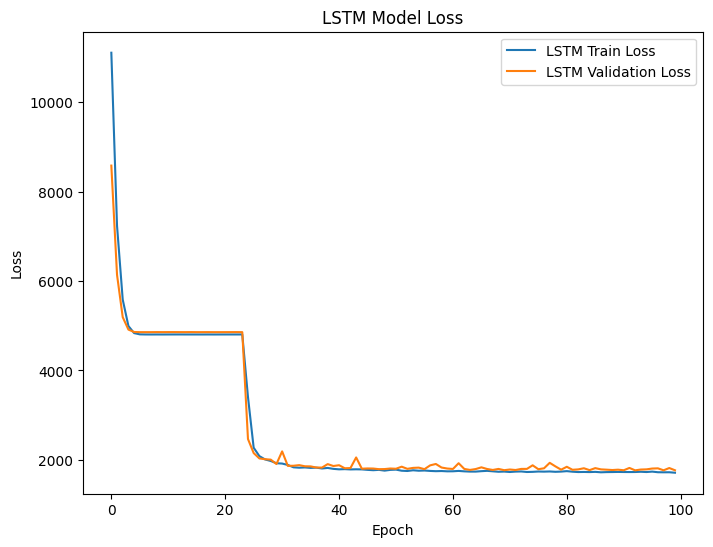

In [ ]:
# Evaluate the best model on the validation set
if best_overall_model == 'LSTM':
    lstm_model, lstm_history = create_and_train_lstm_gru('lstm', best_lstm_params['units'], best_lstm_params['learning_rate'], best_lstm_params['epochs'])
    y_pred_val = lstm_model.predict(X_val.reshape(-1, X_val.shape[1], 1))
    mse_val = mean_squared_error(y_val, y_pred_val)
    print(f"\nValidation MSE for LSTM: {mse_val}")
elif best_overall_model == 'GRU':
    gru_model, gru_history = create_and_train_lstm_gru('gru', best_gru_params['units'], best_gru_params['learning_rate'], best_gru_params['epochs'])
    y_pred_val = gru_model.predict(X_val.reshape(-1, X_val.shape[1], 1))
    mse_val = mean_squared_error(y_val, y_pred_val)
    print(f"\nValidation MSE for GRU: {mse_val}")
else:
    best_model = best_models[best_overall_model]['model']
    y_pred_val = best_model.predict(X_val)
    mse_val = mean_squared_error(y_val, y_pred_val)
    print(f"\nValidation MSE for {best_overall_model}: {mse_val}")
if best_overall_model == 'LSTM':
    plt.figure(figsize=(8, 6))
    plt.plot(lstm_history.history['loss'], label='LSTM Train Loss')
    # Instead of plotting the history object directly, access the 'val_loss' key to plot the validation loss
    plt.plot(lstm_history.history['val_loss'], label='LSTM Validation Loss')
    plt.title('LSTM Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

In [ ]:
# make copy of original dataset , assing new name for dataframes
df1 = data_train.copy()
df1_val = data_val.copy()
print(df1.shape , df1_val.shape)

(20631, 26) (13096, 26)


Engine Health Classification Prediction

In [ ]:
!pip install catboost

In [ ]:
def classify_engine_health_rul(rul):
    if rul == 0:
        return "Unusable"  # Unusable
    elif rul >= 1 and rul <=50:
        return "Danger"  #  Danger Condition
    elif rul >= 51 and rul <=100:
        return "Moderate"  # Moderate Condition
    elif rul >= 101 and rul <=200:
        return "Safe"  # Safe Condition

In [ ]:
def create_rul(df):
    df['rul'] = df.groupby('engine')['time'].transform('max') - df['time']
    return df

df1 = create_rul(df1)

In [ ]:
df1

,engine,time,op_setting_1,op_setting_2,op_setting_3,sm_1,sm_2,sm_3,sm_4,sm_5,...,sm_13,sm_14,sm_15,sm_16,sm_17,sm_18,sm_19,sm_20,sm_21,rul
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,...,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190,191
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,...,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236,190
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,...,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442,189
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,...,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739,188
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,...,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044,187
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20626,100,196,-0.0004,-0.0003,100.0,518.67,643.49,1597.98,1428.63,14.62,...,2388.26,8137.60,8.4956,0.03,397,2388,100.0,38.49,22.9735,4
20627,100,197,-0.0016,-0.0005,100.0,518.67,643.54,1604.50,1433.58,14.62,...,2388.22,8136.50,8.5139,0.03,395,2388,100.0,38.30,23.1594,3
20628,100,198,0.0004,0.0000,100.0,518.67,643.42,1602.46,1428.18,14.62,...,2388.24,8141.05,8.5646,0.03,398,2388,100.0,38.44,22.9333,2
20629,100,199,-0.0011,0.0003,100.0,518.67,643.23,1605.26,1426.53,14.62,...,2388.23,8139.29,8.5389,0.03,395,2388,100.0,38.29,23.0640,1


In [ ]:
def modify_datasets_for_classification(df):
    df['Engine_Health'] = df['rul'].apply(classify_engine_health_rul)
    return df

df1 = modify_datasets_for_classification(df1)

In [ ]:
# Encode classification labels
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
df1['Engine_Health'] = label_encoder.fit_transform(df1['Engine_Health'])

In [ ]:
df1

,engine,time,op_setting_1,op_setting_2,op_setting_3,sm_1,sm_2,sm_3,sm_4,sm_5,...,sm_14,sm_15,sm_16,sm_17,sm_18,sm_19,sm_20,sm_21,rul,Engine_Health
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,...,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190,191,2
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,...,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236,190,2
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,...,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442,189,2
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,...,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739,188,2
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,...,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044,187,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20626,100,196,-0.0004,-0.0003,100.0,518.67,643.49,1597.98,1428.63,14.62,...,8137.60,8.4956,0.03,397,2388,100.0,38.49,22.9735,4,0
20627,100,197,-0.0016,-0.0005,100.0,518.67,643.54,1604.50,1433.58,14.62,...,8136.50,8.5139,0.03,395,2388,100.0,38.30,23.1594,3,0
20628,100,198,0.0004,0.0000,100.0,518.67,643.42,1602.46,1428.18,14.62,...,8141.05,8.5646,0.03,398,2388,100.0,38.44,22.9333,2,0
20629,100,199,-0.0011,0.0003,100.0,518.67,643.23,1605.26,1426.53,14.62,...,8139.29,8.5389,0.03,395,2388,100.0,38.29,23.0640,1,0


In [ ]:
# Prepare features and target
X = df1.drop(['Engine_Health', 'rul'], axis=1)
y = df1['Engine_Health']

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

Training Random Forest...
Classification Report for Random Forest:
              precision    recall  f1-score   support

           0       0.88      0.84      0.86       966
           1       0.66      0.67      0.67       967
           2       0.75      0.88      0.81      1789
           3       1.00      0.06      0.11        18
           4       0.81      0.27      0.40       387

    accuracy                           0.76      4127
   macro avg       0.82      0.54      0.57      4127
weighted avg       0.77      0.76      0.75      4127



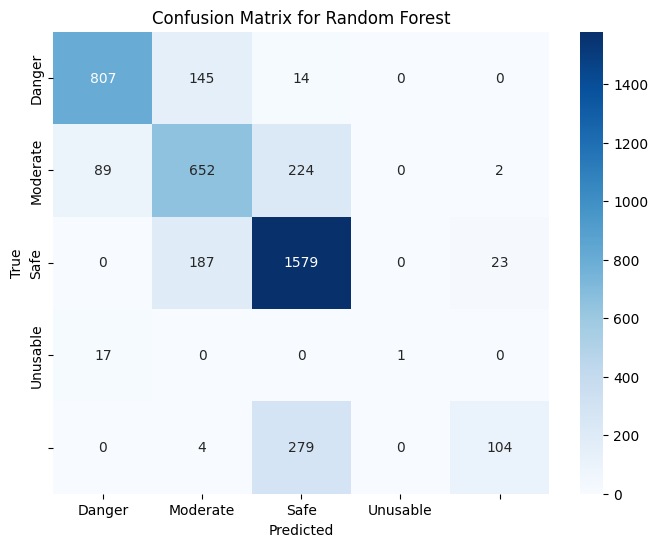

Training CatBoost...
Classification Report for CatBoost:
              precision    recall  f1-score   support

           0       0.92      0.90      0.91       966
           1       0.81      0.84      0.82       967
           2       0.90      0.94      0.92      1789
           3       0.17      0.06      0.08        18
           4       0.94      0.76      0.84       387

    accuracy                           0.88      4127
   macro avg       0.75      0.70      0.71      4127
weighted avg       0.88      0.88      0.88      4127



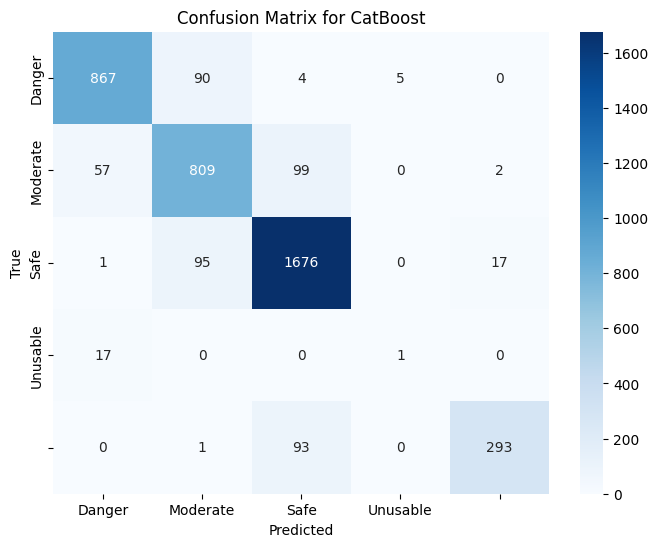

Training Logistic Regression...


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no pre

Classification Report for Logistic Regression:
              precision    recall  f1-score   support

           0       0.81      0.78      0.80       966
           1       0.54      0.49      0.51       967
           2       0.67      0.83      0.74      1789
           3       0.00      0.00      0.00        18
           4       0.28      0.05      0.09       387

    accuracy                           0.67      4127
   macro avg       0.46      0.43      0.43      4127
weighted avg       0.63      0.67      0.64      4127



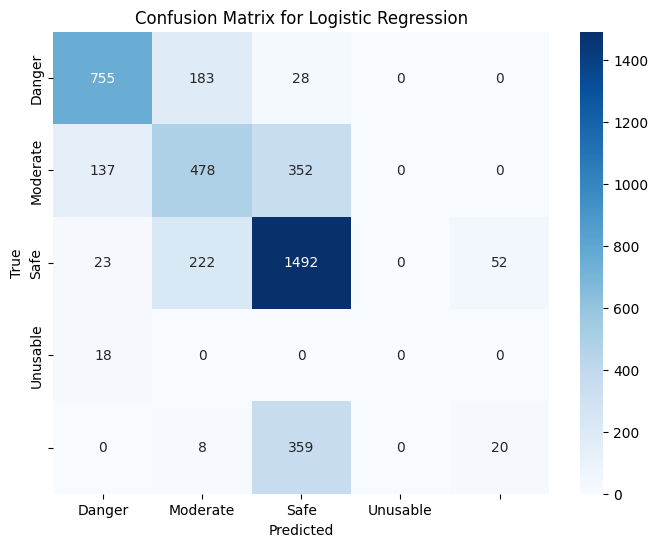


Best Model based on accuracy: CatBoost
Training Random Forest...
Classification Report for Random Forest:
              precision    recall  f1-score   support

           0       0.88      0.85      0.86       966
           1       0.66      0.66      0.66       967
           2       0.75      0.89      0.81      1789
           3       1.00      0.06      0.11        18
           4       0.82      0.28      0.42       387

    accuracy                           0.76      4127
   macro avg       0.82      0.54      0.57      4127
weighted avg       0.77      0.76      0.75      4127



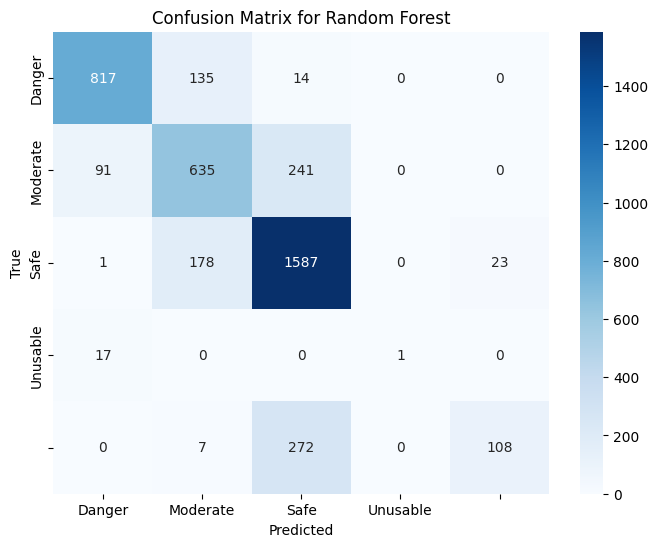

Training CatBoost...
Classification Report for CatBoost:
              precision    recall  f1-score   support

           0       0.92      0.90      0.91       966
           1       0.81      0.84      0.82       967
           2       0.90      0.94      0.92      1789
           3       0.17      0.06      0.08        18
           4       0.94      0.76      0.84       387

    accuracy                           0.88      4127
   macro avg       0.75      0.70      0.71      4127
weighted avg       0.88      0.88      0.88      4127



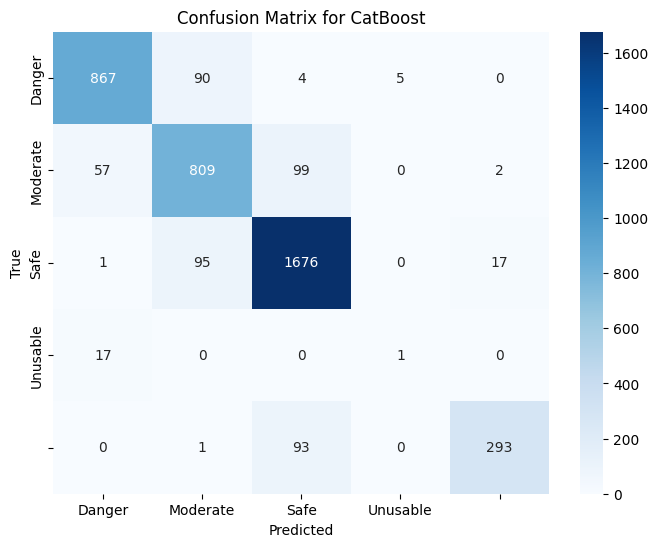

Training Logistic Regression...


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no pre

Classification Report for Logistic Regression:
              precision    recall  f1-score   support

           0       0.81      0.78      0.80       966
           1       0.54      0.49      0.51       967
           2       0.67      0.83      0.74      1789
           3       0.00      0.00      0.00        18
           4       0.28      0.05      0.09       387

    accuracy                           0.67      4127
   macro avg       0.46      0.43      0.43      4127
weighted avg       0.63      0.67      0.64      4127



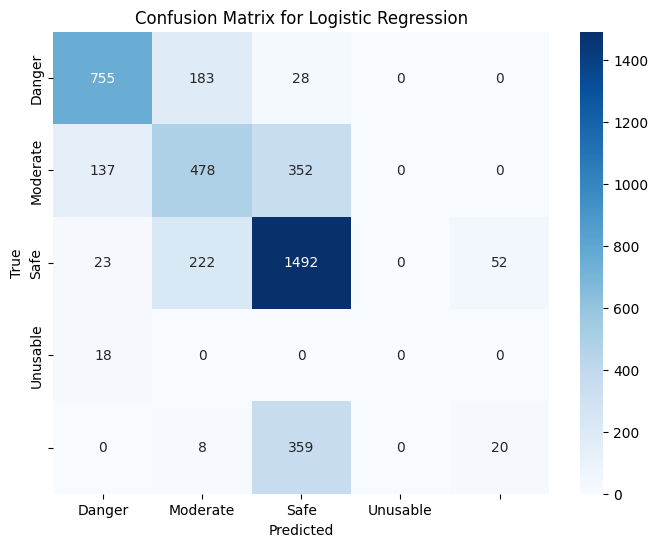


Best Model based on accuracy: CatBoost
Performance Metrics:
Accuracy: 0.8835
Precision: 0.8828
Recall: 0.8835
F1-Score: 0.8818


In [ ]:
# Train and evaluate models
model_results = {}
for model_name, model in classification_models.items():
    print(f"Training {model_name}...")
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, average='weighted')
    recall = recall_score(y_test, y_pred, average='weighted')
    f1 = f1_score(y_test, y_pred, average='weighted')
    model_results[model_name] = {
        "Accuracy": accuracy,
        "Precision": precision,
        "Recall": recall,
        "F1-Score": f1
    }
    print(f"Classification Report for {model_name}:\n{classification_report(y_test, y_pred)}")

    cm = confusion_matrix(y_test, y_pred)
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
    plt.title(f'Confusion Matrix for {model_name}')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.show()

# Compare model performance and suggest the best model
best_model = max(model_results, key=lambda k: model_results[k]["Accuracy"])
print(f"\nBest Model based on accuracy: {best_model}")
# Train and evaluate models
model_results = {}
for model_name, model in classification_models.items():
    print(f"Training {model_name}...")
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, average='weighted')
    recall = recall_score(y_test, y_pred, average='weighted')
    f1 = f1_score(y_test, y_pred, average='weighted')
    model_results[model_name] = {
        "Accuracy": accuracy,
        "Precision": precision,
        "Recall": recall,
        "F1-Score": f1
    }
    print(f"Classification Report for {model_name}:\n{classification_report(y_test, y_pred)}")

    cm = confusion_matrix(y_test, y_pred)
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
    plt.title(f'Confusion Matrix for {model_name}')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.show()

# Compare model performance and suggest the best model
best_model = max(model_results, key=lambda k: model_results[k]["Accuracy"])
print(f"\nBest Model based on accuracy: {best_model}")
print("Performance Metrics:")
for metric, value in model_results[best_model].items():
    print(f"{metric}: {value:.4f}")
